In [94]:
# Visualization Stuff

%matplotlib inline
from matplotlib import pyplot as plt
from matplotlib import colors
import matplotlib.gridspec as gridspec
from mne.viz import circular_layout, plot_connectivity_circle
import itertools
%pylab inline 

from matplotlib.backends.backend_pdf import PdfPages
from IPython.display import Image,HTML,clear_output,display as d
from nilearn.plotting import plot_roi,plot_anat

import os;
import os,sys,pandas as pd,numpy as np, scipy


Populating the interactive namespace from numpy and matplotlib


`%matplotlib` prevents importing * from pylab and numpy


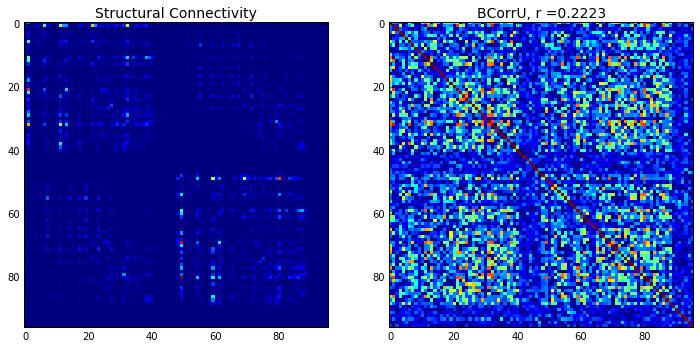

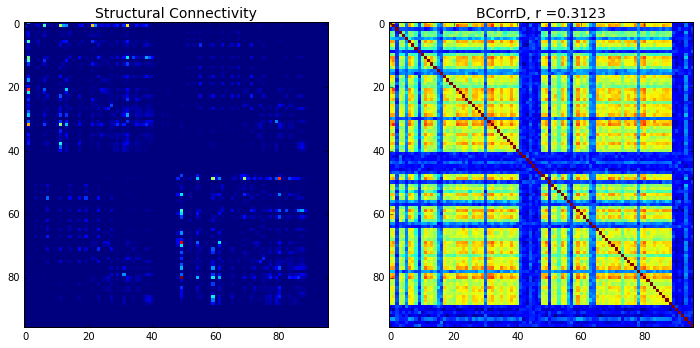

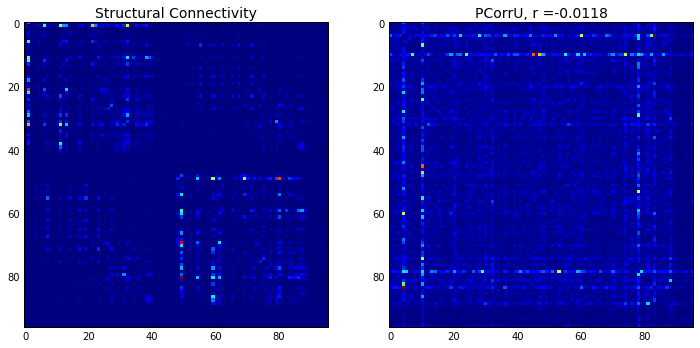

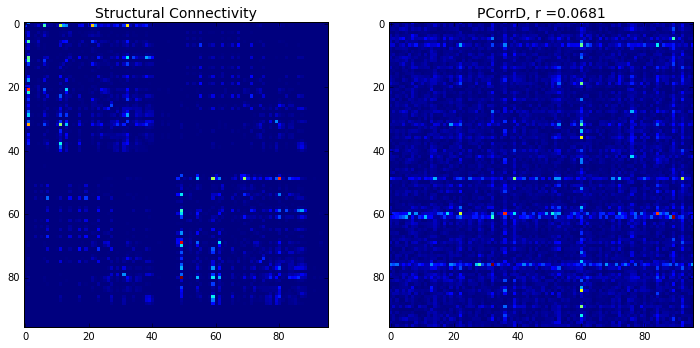

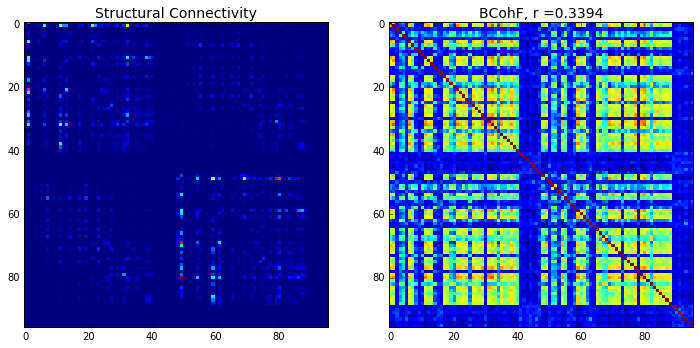

...

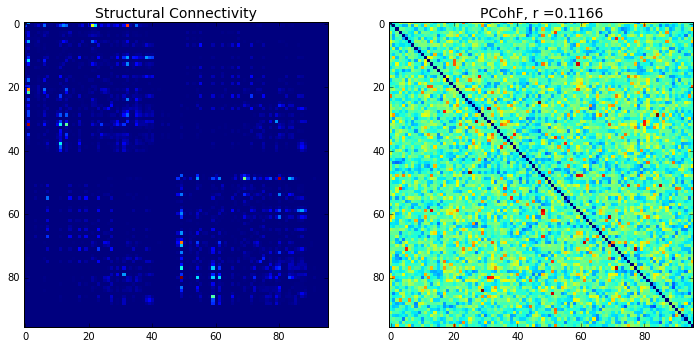

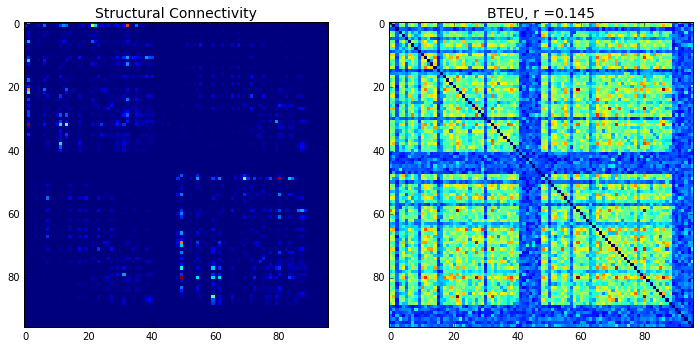

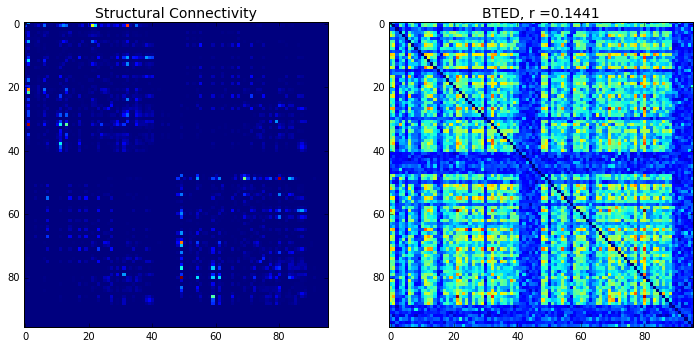

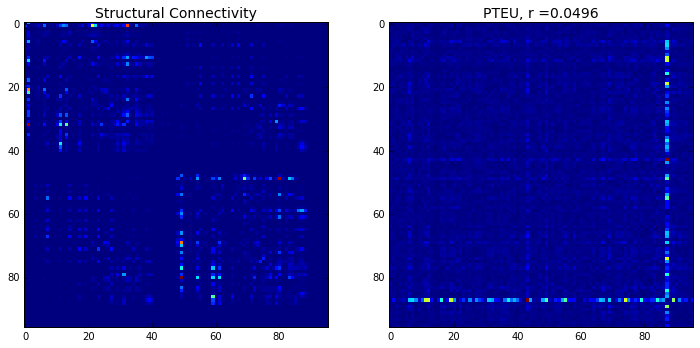

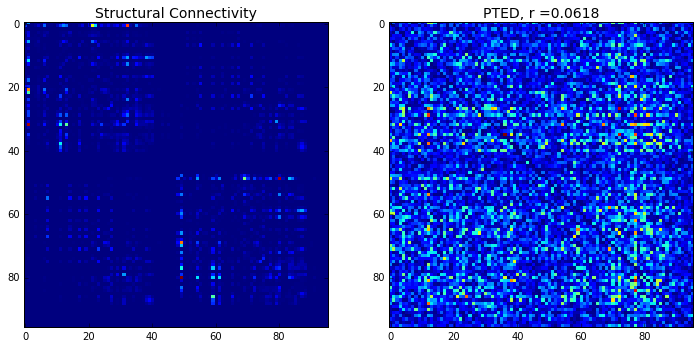

In [101]:
## Parameters

win = ['50', '60', '70', '80', '90','100']
subID = ['00001', '29233']
filesuffix = ['1_0', '2_0', '3_0']
meas = ['BCorrU','BCorrD', 'PCorrU', 'PCorrD', 'BCohF', 'PCohF', 'BTEU', 'BTED', 'PTEU', 'PTED']

allR = np.zeros((np.shape(win)[0],np.shape(subID)[0],np.shape(filesuffix)[0],np.shape(meas)[0]))

dir_current = os.getcwd()
results_dir = dir_current + '/mresults/abide_jan15/'
outdir = results_dir + 'vizresults/'
if not os.path.isdir(outdir): os.makedirs(outdir)

for w in range(np.shape(win)[0]):
    
    for s in range(np.shape(subID)[0]):
        
        for f in range(np.shape(filesuffix)[0]):

            filename = 'Tout_' + win[w] + '_' + subID[s] + '_' + filesuffix[f]

            subfile = results_dir + filename + '.mat'
            pdf=PdfPages(outdir + filename + '.pdf')    

            matdata = scipy.io.loadmat(subfile)

            for i in range(np.shape(meas)[0]):

                sc = scipy.io.loadmat(results_dir + subID[s] + '_' + filesuffix[f] + '.mat')
                sc = sc['Connectivity']

                cdata = matdata[meas[i]]
                cdata = np.absolute(np.mean(cdata,axis=2))

                fig = figure(figsize = (12, 6))

                ax1=subplot(121);
                plt.imshow(sc,interpolation='nearest');
                plt.title('Structural Connectivity',fontsize=14);

                ax1=subplot(122);
                plt.imshow(cdata,interpolation='nearest');
                # plt.title(meas[i]+ ', r =' + r, fontsize=14);

                scv = sc;
                for r in range(scv.shape[0]):
                        scv[r:,r]=numpy.inf
                scv = scv[~numpy.isinf(scv)]

                cdatav = cdata;
                for r in range(cdatav.shape[0]):
                    cdatav[r:,r]=numpy.inf
                cdatav = cdatav[~numpy.isinf(cdatav)]

                r = corrcoef(scv.ravel(), cdatav.ravel())[1, 0]
                r = round(r,4)
                allR[w,s,f,i] = r;
                r = str(r)

                plt.title(meas[i] + ', r =' + r, fontsize=14);

                pdf.savefig(fig)
                plt.show()

            pdf.close()


In [105]:
#matoutfile = 
scipy.io.savemat(results_dir+'allR.mat',mdict={'allR':allR})